# New York City Taxi Trip Duration Project

The goal of this project is to present a solution for the Kaggle's playground competition [New York City Taxi Trip Duration](https://www.kaggle.com/c/nyc-taxi-trip-duration).

The competition dataset is based on the [2016 NYC Yellow Cab trip record data](https://cloud.google.com/bigquery/public-data/nyc-tlc-trips) made available in Big Query on Google Cloud Platform. The data was originally published by the [NYC Taxi and Limousine Commission (TLC)](http://www.nyc.gov/html/tlc/html/about/trip_record_data.shtml). It was sampled and cleaned for the purposes of the playground competition. Based on individual trip attributes, we should predict the duration of each trip in the test set.

After accepting [Kaggle's Terms](https://www.kaggle.com/terms), the data can downloaded from two zip files, one containing the [training dataset](https://www.kaggle.com/c/6960/download/train.zip) and other the [testing dataset](https://www.kaggle.com/c/6960/download/test.zip). Additionally, a [sample submission file](https://www.kaggle.com/c/6960/download/sample_submission.zip) is provided.

## Loading the data

To begin, we first load the basic libraries.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('ggplot')

File descriptions

- `train.csv` - the training set (contains 1458644 trip records)
- `test.csv` - the testing set (contains 625134 trip records)
- `sample_submission.csv` - a sample submission file in the correct format

In [2]:
train_data = pd.read_csv('train.csv', index_col= 'id')
test_data = pd.read_csv('test.csv', index_col= 'id')
sample_submission = pd.read_csv('sample_submission.csv', index_col= 'id')

Data fields

- `id` - a unique identifier for each trip
- `vendor_id` - a code indicating the provider associated with the trip record
- `pickup_datetime` - date and time when the meter was engaged
- `dropoff_datetime` - date and time when the meter was disengaged
- `passenger_count` - the number of passengers in the vehicle (driver entered value)
- `pickup_longitude` - the longitude where the meter was engaged
- `pickup_latitude` - the latitude where the meter was engaged
- `dropoff_longitude` - the longitude where the meter was disengaged
- `dropoff_latitude` - the latitude where the meter was disengaged
- `store_and_fwd_flag` - This flag indicates whether the trip record was held in vehicle memory before sending to the vendor because the vehicle did not have a connection to the server -`Y`=store and forward; `N`=not a store and forward trip
- `trip_duration` - duration of the trip in seconds

Using the `head()` method we can take a look on both datasets, as well in the sample submission files, which shows how our output should look like for submission.

In [3]:
train_data.head()

,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
id,,,,,,,,,,
id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


It is clear that `trip_duration` is the target variable.

In [4]:
test_data.head()

,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag
id,,,,,,,,
id3004672,1,2016-06-30 23:59:58,1,-73.988129,40.732029,-73.990173,40.756680,N
id3505355,1,2016-06-30 23:59:53,1,-73.964203,40.679993,-73.959808,40.655403,N
id1217141,1,2016-06-30 23:59:47,1,-73.997437,40.737583,-73.986160,40.729523,N
id2150126,2,2016-06-30 23:59:41,1,-73.956070,40.771900,-73.986427,40.730469,N
id1598245,1,2016-06-30 23:59:33,1,-73.970215,40.761475,-73.961510,40.755890,N


In [5]:
sample_submission.head()

,trip_duration
id,
id3004672,959
id3505355,959
id1217141,959
id2150126,959
id1598245,959


For the sake of security, we look for missing values in the data sets.

In [6]:
pd.DataFrame.sum(pd.isnull(train_data))

vendor_id             0
pickup_datetime       0
dropoff_datetime      0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
trip_duration         0
dtype: int64

In [7]:
print(pd.DataFrame.sum(pd.isnull(test_data)))

vendor_id             0
pickup_datetime       0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
dtype: int64


Since the training data set provides the column `trip duration`, the feature `dropoff_datetime` is irrelevant. Any investigation considering rush hours and holidays in New York City can be performed only with the feature `pickup_datetime`.

In [3]:
train_data = train_data.drop(columns=['dropoff_datetime'])
train_data.head()

,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
id,,,,,,,,,
id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455
id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663
id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429
id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435


It is convenient to use the `datetime` [module](https://docs.python.org/3/library/datetime.html) in the column `pickup_datetime` to easily extract interesting information about [dates and hours](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.to_datetime.html).

In [4]:
train_data['pickup_datetime'] = pd.to_datetime( train_data['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
test_data['pickup_datetime'] = pd.to_datetime( test_data['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')

Visually, the data frame does not chance, but soon the benefit of working with `datetime` objects will be clear.

In [10]:
train_data.head()

,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
id,,,,,,,,,
id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455
id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663
id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429
id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435


## Data exploration and cleaning

First we take a look at the target variable.

### Trip duration

Clearly the distribution of `trip_duration` is skewed, suggesting we should apply a logarithmic transformation before training.

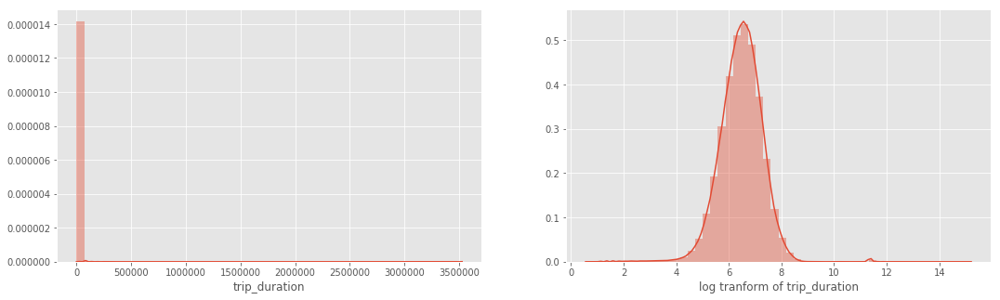

In [11]:
fig, axes = plt.subplots(1, 2)
axes = axes.flatten()
fig.set_size_inches(18, 5)

sns.distplot(train_data['trip_duration'], axlabel= 'trip_duration', ax=axes[0])
# Log transformation
log_transform = np.log(train_data['trip_duration'] + 1)
sns.distplot(log_transform, axlabel='log tranform of trip_duration', ax=axes[1])
plt.show()

We also should be careful with some meaningless values (outliers), like the maximum value, which would represent a forty days taxi trip around New York. Rush hour cannot be that bad.

In [12]:
train_data.describe()['trip_duration']/60

count    24310.733333
mean        15.991538
std         87.290529
min          0.016667
25%          6.616667
50%         11.033333
75%         17.916667
max      58771.366667
Name: trip_duration, dtype: float64

For now, we will keep even these data points. Below we will define a travel distance and then neglect the outliers both related with travel distance and trip duration.

### Localization coordinates and travel distances

It is also interesting to take a more careful look in the coordinates.

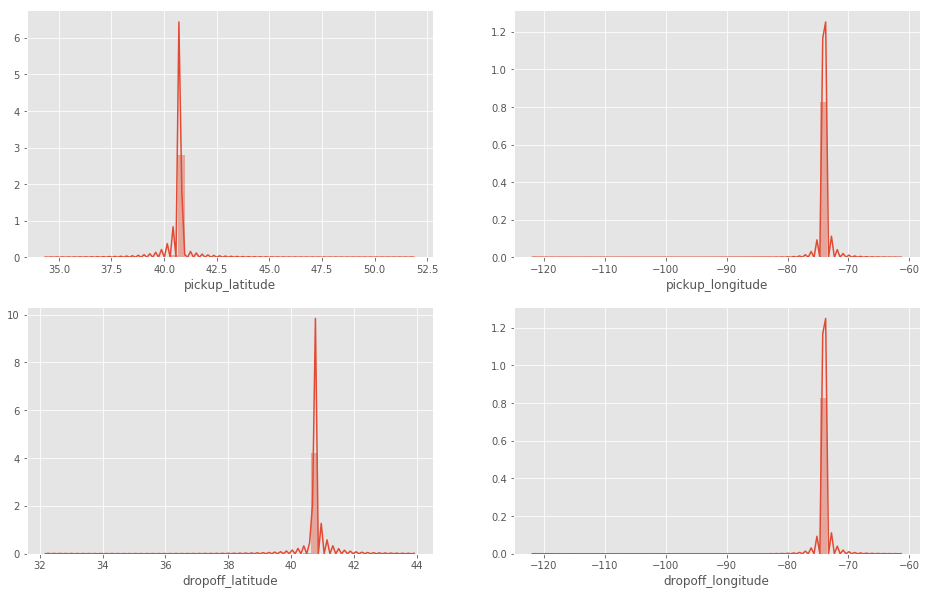

In [13]:
f, axes = plt.subplots(2,2,figsize=(16, 10), sharex=False, sharey = False)
sns.distplot(train_data['pickup_latitude'], axlabel = 'pickup_latitude',ax=axes[0,0])
sns.distplot(train_data['pickup_longitude'], axlabel = 'pickup_longitude', ax=axes[0,1])
sns.distplot(train_data['dropoff_latitude'], axlabel = 'dropoff_latitude', ax=axes[1, 0])
sns.distplot(train_data['dropoff_longitude'], axlabel = 'dropoff_longitude', ax=axes[1, 1])
plt.show()

Visually, we can infer that most of latitude coordinates vary from 40 to 42, while longitude from -80 to -70. Many interesting map visualization and improved analysis could be carried on with these coordinates, as done in many Kaggle [kernels](https://www.kaggle.com/c/nyc-taxi-trip-duration/kernels) related with this competition). Nevertheless, at least for now, we will keep our model as simple as possible and the information from the four columns above will be merged in just one new feature.

Certainly, we have to relate the variables `pickup_longitude`, `pickup_latitude`, `dropoff_longitude` and `dropoff_latitude` with `trip_duration`. First let us create an $L_1$ distance function in two dimensions. This $l_1$ norm is known as [taxicab metric](https://en.wikipedia.org/wiki/Taxicab_geometry) or Manhattan distance.

The function also [coverts](https://www.thoughtco.com/degree-of-latitude-and-longitude-distance-4070616) the respective latitude and longitude differences from degrees to kilometers.

In [5]:
def L1_distance_2D(x1, y1, x2, y2):
    # Latitude approximate conversion: degrees to kilometers
    x_conversion = 111
    # Longitude approximate conversion: degrees to kilometers
    y_conversion =  111.321
    # Calculation of the Manhattan distance in kilometers
    dist = x_conversion*np.absolute(x2 - x1) + y_conversion*np.absolute(y2 - y1)
    return dist

Then we calculate the Manhattan distance for each instance in `train_data`. After that we will no longer need the coordinates features.

In [6]:
x1 = train_data['pickup_latitude']
y1 = train_data['pickup_longitude']
x2 = train_data['dropoff_latitude']
y2 = train_data['dropoff_longitude']

train_data = train_data.drop(columns=['pickup_latitude', 'pickup_longitude', 
                                      'dropoff_latitude', 'dropoff_longitude'])

train_data['travel_distance_km'] = L1_distance_2D(x1, y1, x2, y2)

In [7]:
train_data.head()

,vendor_id,pickup_datetime,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km
id,,,,,,
id2875421,2,2016-03-14 17:24:55,1,N,455,2.210009
id2377394,1,2016-06-12 00:43:35,1,N,663,2.945157
id3858529,2,2016-01-19 11:35:24,1,N,2124,8.906008
id3504673,2,2016-04-06 19:32:31,1,N,429,1.719000
id2181028,2,2016-03-26 13:30:55,1,N,435,1.200893


We cannot forget to do the same for `test_data`.

In [8]:
x1 = test_data['pickup_latitude']
y1 = test_data['pickup_longitude']
x2 = test_data['dropoff_latitude']
y2 = test_data['dropoff_longitude']

test_data = test_data.drop(columns=['pickup_latitude', 'pickup_longitude', 
                                      'dropoff_latitude', 'dropoff_longitude'])

test_data['travel_distance_km'] = L1_distance_2D(x1, y1, x2, y2)

Onde we have created the new feature `travel_distance_km`, we can analyse its distribution, just like we did for `trip_duration`. Clearly the distribution is skewed, suggesting we should apply a logarithmic transformation before training.

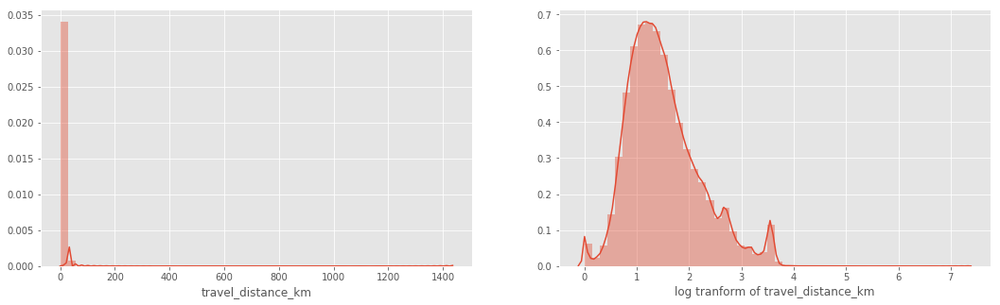

In [18]:
fig, axes = plt.subplots(1, 2)
axes = axes.flatten()
fig.set_size_inches(18, 5)

sns.distplot(train_data['travel_distance_km'], axlabel= 'travel_distance_km', ax=axes[0])
# Log transformation
log_transform = np.log(train_data['travel_distance_km'] + 1)
sns.distplot(log_transform, axlabel='log tranform of travel_distance_km', ax=axes[1])
plt.show()

## Meaningless examples

The figures above indicate we should be careful with outliers. From the application of the `describe` method on `train_data` we can see that, strangely, at least one instance has the value zero for `travel_distance_km`.

In [19]:
train_data.describe()[['travel_distance_km']]

,travel_distance_km
count,1.458644e+06
mean,5.102859e+00
std,6.637813e+00
min,0.000000e+00
25%,1.788463e+00
50%,3.043757e+00
75%,5.610539e+00
max,1.435183e+03


Taking a careful look on those cases, we note there are several rows with `travel_distance_km == 0`.

In [9]:
zero_travel_distance = train_data.loc[ train_data['travel_distance_km'] == 0 ]

print(zero_travel_distance.shape[0])
zero_travel_distance.head()

5897


,vendor_id,pickup_datetime,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km
id,,,,,,
id3487442,2,2016-02-29 18:39:12,1,N,227,0.0
id0924324,2,2016-05-10 18:07:52,2,N,1109,0.0
id1145809,2,2016-05-16 23:15:13,6,N,947,0.0
id3499387,1,2016-01-25 19:45:12,1,N,580,0.0
id0753277,1,2016-01-27 22:29:31,1,N,27,0.0


Since those trips do not make sense we will throw them away.

In [10]:
train_data = train_data.drop( zero_travel_distance.index.values )

Some data points in the train dataset are still not reliable, since the magnitude of their values for the feature `trip_duration` is of order of ten thousands minutes.

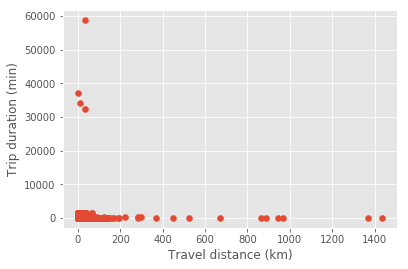

In [22]:
plt.scatter(train_data['travel_distance_km'], train_data['trip_duration']/60 )
plt.xlabel('Travel distance (km)')
plt.ylabel('Trip duration (min)')
plt.show()

In [23]:
train_data.loc[ train_data['trip_duration'] > 10000*60 ]

,vendor_id,pickup_datetime,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km
id,,,,,,
id1864733,1,2016-01-05 00:19:42,1,N,1939736,32.986035
id0369307,1,2016-02-13 22:38:00,2,N,2049578,9.765943
id1325766,1,2016-01-05 06:14:15,1,N,2227612,1.815373
id0053347,1,2016-02-13 22:46:52,1,N,3526282,32.911353


Although the taxi mean speed might hide important information about the city traffic, it is certainly suspicious when its value is less then 0.1 km/h in travels up to 33 km.

In [11]:
trip_duration_outliers = train_data.loc[ train_data['trip_duration'] > 10000*60 ]
# Mean speed (km/h)
3600*trip_duration_outliers['travel_distance_km'] / trip_duration_outliers['trip_duration']

id
id1864733    0.061220
id0369307    0.017153
id1325766    0.002934
id0053347    0.033599
dtype: float64

Below we remove from `train_data` the lines shown in `trip_duration_outliers`.

In [12]:
train_data = train_data.drop( trip_duration_outliers.index.values )

The same analysis can be done looking for non-reliable data points from the point of view of the travel distance. 

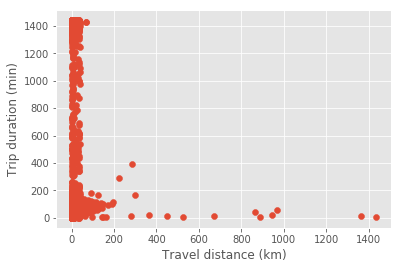

In [26]:
plt.scatter(train_data['travel_distance_km'], train_data['trip_duration'] / 60)
plt.xlabel('Travel distance (km)')
plt.ylabel('Trip duration (min)')
plt.show()

In [27]:
train_data.loc[ train_data['travel_distance_km'] > 300 ]

,vendor_id,pickup_datetime,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km
id,,,,,,
id2306955,1,2016-05-07 18:58:53,1,N,792,1366.570929
id0978162,1,2016-02-24 16:20:59,4,N,875,450.093539
id0116374,1,2016-04-02 20:33:19,1,N,282,525.671038
id0982904,1,2016-04-28 13:32:14,2,N,2515,862.940736
id1146400,1,2016-02-15 18:57:32,2,N,303,889.430505
id1001696,1,2016-02-24 21:02:32,1,N,1405,944.907080
id1510552,2,2016-01-06 20:40:52,5,N,611,1435.183382
id3626673,1,2016-05-05 18:02:50,1,N,933,671.153250
id0838705,1,2016-02-26 19:50:03,1,N,1131,366.990825


The mean speed for those data points does not make sense either.

In [13]:
travel_distance_outliers = train_data.loc[  train_data['travel_distance_km'] > 300]
# Mean speed (km/h)
3600*travel_distance_outliers['travel_distance_km'] / travel_distance_outliers['trip_duration']

id
id2306955     6211.686039
id0978162     1851.813416
id0116374     6710.694096
id0982904     1235.223321
id1146400    10567.491153
id1001696     2421.114225
id1510552     8456.072300
id3626673     2589.658842
id0838705     1168.140557
id2644780     1065.878866
dtype: float64

Below we remove from `train_data` the lines shown in `travel_distance_outliers`.

In [14]:
train_data = train_data.drop( travel_distance_outliers.index.values )

Checking the new scatter plot.

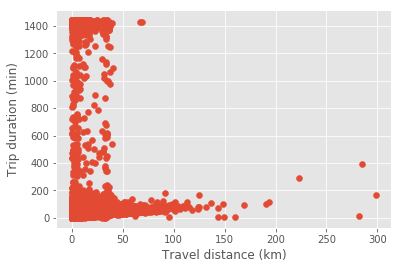

In [30]:
plt.scatter(train_data['travel_distance_km'], train_data['trip_duration'] / 60)
plt.xlabel('Travel distance (km)')
plt.ylabel('Trip duration (min)')
plt.show()

There are more outliers with inconsistent mean speed values which can be dropped from the training data.

In [15]:
more_distance_outliers = train_data.loc[  train_data['travel_distance_km'] > 150]
# Mean speed (km/h)
mean_speed_more = 3600*more_distance_outliers['travel_distance_km'] / more_distance_outliers['trip_duration']
mean_speed_more

id
id1092161      97.220917
id1311087      43.787064
id2778014    1351.784060
id2066082     109.625331
id0401529    1261.852560
id0687776     116.109127
id1216866     108.340772
id3795134      46.182152
dtype: float64

In [16]:
train_data = train_data.drop( (mean_speed_more > 120).index.values )

This leads us to the following scatter plot.

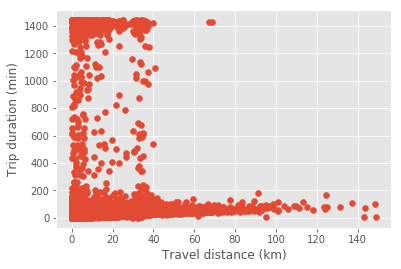

In [33]:
plt.scatter(train_data['travel_distance_km'], train_data['trip_duration'] / 60)
plt.xlabel('Travel distance (km)')
plt.ylabel('Trip duration (min)')
plt.show()

## Rush hour and days in New York City

Naturally, rush hour periods and weekends could change taxi trip duration. Since `pickup_datetime` feature is a `datetime` object, it is not difficult to label each instance with the [week day](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.Series.dt.weekday_name.html) the trip was taken.

In [17]:
train_data['week_day'] = train_data['pickup_datetime'].dt.weekday_name
test_data['week_day'] = test_data['pickup_datetime'].dt.weekday_name

In [18]:
train_data.head()

,vendor_id,pickup_datetime,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km,week_day
id,,,,,,,
id2875421,2,2016-03-14 17:24:55,1,N,455,2.210009,Monday
id2377394,1,2016-06-12 00:43:35,1,N,663,2.945157,Sunday
id3858529,2,2016-01-19 11:35:24,1,N,2124,8.906008,Tuesday
id3504673,2,2016-04-06 19:32:31,1,N,429,1.719000,Wednesday
id2181028,2,2016-03-26 13:30:55,1,N,435,1.200893,Saturday


In many cities around the world there are reasonable well defined periods of time called rush hours, on which one should not (if possible) drive into the city. Usually rush hours take place take early in the morning and in the end of afternoon.

In New York City, however, there are [longer periods of rush hours](https://www.nytimes.com/1987/09/09/nyregion/new-york-rush-hours-grow-earlier-and-later.html). Some people even claim that [all times](https://www.quora.com/What-times-are-considered-rush-hour-in-New-York-City) are rush hours. Naturally, another important feature would be the name of the street where the taxi trip begins. Rush hours periods near [airports](https://adventure.howstuffworks.com/new-york-city-guide1.htm), for example, could be longer. Such deeper analysis could be performed from latitude and longitude coordinates or even with the help of [additional datasets](https://www.kaggle.com/maheshdadhich/strength-of-visualization-python-visuals-tutorial/data), but it will not be carried here.

In order to eventually define a rush hour period and to analyze the behavior of the data for different days of the week, we seek to calculate the average trip duration per hour. First, we extract the hour in which each trip started from the `datetime` objects, and create a new variable called `pickup_hour`.

In [19]:
train_data['pickup_hour'] = train_data['pickup_datetime'].dt.hour
test_data['pickup_hour'] = test_data['pickup_datetime'].dt.hour

train_data.head()

,vendor_id,pickup_datetime,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km,week_day,pickup_hour
id,,,,,,,,
id2875421,2,2016-03-14 17:24:55,1,N,455,2.210009,Monday,17
id2377394,1,2016-06-12 00:43:35,1,N,663,2.945157,Sunday,0
id3858529,2,2016-01-19 11:35:24,1,N,2124,8.906008,Tuesday,11
id3504673,2,2016-04-06 19:32:31,1,N,429,1.719000,Wednesday,19
id2181028,2,2016-03-26 13:30:55,1,N,435,1.200893,Saturday,13


Using pandas `groupby` [method](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.groupby.html) we calculate the average values of `trip_duration` for each value of `pickup_hour` and organize them considering each day of the week.

In [37]:
avr_trip_duration = pd.DataFrame( train_data.groupby(['week_day', 'pickup_hour'])['trip_duration'].mean() )
avr_trip_duration = avr_trip_duration.unstack(level=0).copy()
avr_trip_duration

trip_duration                                                      \
week_day           Friday       Monday     Saturday       Sunday     Thursday   
pickup_hour                                                                     
0              933.487755   798.455820   954.999659   915.095686   890.984375   
1              889.108015   762.932296   974.923711   937.079493   849.080409   
2              825.973825   741.969128   998.091009   895.017523   721.394577   
3             1129.250600   851.185338   849.756451   901.749671   704.343730   
4              974.198523   886.256888  1068.307974   890.087492   722.013062   
5              862.209217   806.244621   930.919517   890.410375   809.519170   
6              738.020452   736.370572   794.892320   832.822482   764.665782   
7              884.949358   836.147299   706.132325   704.214109   842.596412   
8              916.224910   962.318191   741.907709   625.640847  1003.439512   
9             1007.134798   970.538824   747.048948   690.061553   988.367004   
10             975.681985   932.625903   758.513886   730.716132  1058.525461   
11            1023.280702   923.934158   819.237811   803.024110  1118.473367   
12            1062.269745   924.871287   817.081361   886.692685  1119.338116   
13            1070.658563   982.750055   937.662252   926.633333  1111.335586   
14            1129.915461   963.784049  1021.769529  1001.182008  1200.624518   
15            1237.755132  1033.808654   998.092001  1034.626023  1202.298403   
16            1155.377189  1073.149167   960.138242   946.903480  1181.375889   
17            1043.364381   971.821693   988.881619   991.067330  1079.688364   
18             993.740508   914.314970   988.086270  1013.919747  1003.376177   
19             923.961781   816.813284   968.013005   918.137604   925.969742   
20             917.213403   771.389985   935.332409   934.620811   949.608878   
21             917.226765   799.458180   919.730335   882.066145   953.596001   
22             971.924605   858.618883   978.625710   918.128548  1035.679955   
23            1008.341740   802.302047   969.969438   904.145177   923.725892   

                                       
week_day         Tuesday    Wednesday  
pickup_hour                            
0             865.552339   831.722767  
1             855.254092   793.553634  
2             962.919893   821.567941  
3             758.708167   881.208038  
4             943.285211   780.577047  
5             763.354472   720.413295  
6             668.783220   687.411380  
7             829.153393   859.990985  
8             959.938797   988.587947  
9            1013.663185   977.550512  
10           1021.635574  1039.726888  
11           1056.674356  1039.482439  
12           1078.988871  1092.567179  
13           1098.646759  1118.454312  
14           1078.130657  1137.514383  
15           1121.963692  1217.833900  
16           1168.531454  1121.664649  
17           1067.690504  1086.670272  
18            942.488339  1030.960280  
19            855.247711   860.074324  
20            833.456460   829.600427  
21            858.755478   896.465262  
22            942.840743   939.959298  
23            891.845119   895.072688

The data frame above allow us produce a nice visualization plot in a easy way. Here we choose to take advantage of the
`plotly` [library](https://plot.ly/).

In [38]:
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode()

d0 = go.Scatter(x= avr_trip_duration['trip_duration']['Monday'].index.values, 
                y= avr_trip_duration['trip_duration']['Monday'].values/60, 
                mode = 'lines+markers', name= 'Monday')

d1 = go.Scatter(x= avr_trip_duration['trip_duration']['Tuesday'].index.values, 
                y= avr_trip_duration['trip_duration']['Tuesday'].values/60, 
                mode = 'lines+markers', name= 'Tuesday')

d2 = go.Scatter(x= avr_trip_duration['trip_duration']['Wednesday'].index.values, 
                y= avr_trip_duration['trip_duration']['Wednesday'].values/60, 
                mode = 'lines+markers', name= 'Wednesday')

d3 = go.Scatter(x= avr_trip_duration['trip_duration']['Thursday'].index.values, 
                y= avr_trip_duration['trip_duration']['Thursday'].values/60, 
                mode = 'lines+markers', name= 'Thursday')

d4 = go.Scatter(x= avr_trip_duration['trip_duration']['Friday'].index.values, 
                y= avr_trip_duration['trip_duration']['Friday'].values/60, 
                mode = 'lines+markers', name= 'Friday')

d5 = go.Scatter(x= avr_trip_duration['trip_duration']['Saturday'].index.values, 
                y= avr_trip_duration['trip_duration']['Saturday'].values/60, 
                mode = 'lines+markers', name= 'Saturday')

d6 = go.Scatter(x= avr_trip_duration['trip_duration']['Sunday'].index.values, 
                y= avr_trip_duration['trip_duration']['Sunday'].values/60, 
                mode = 'lines+markers', name= 'Sunday')

data = [d0, d1, d2, d3, d4, d5, d6]

layout = dict(title = "Average trip duration per hour- Days of the week", xaxis = dict(range = ['0','23'],
                                                                    title= 'Hour',
                                                                    dtick=1.0),
             yaxis = dict(title= 'Average trip duration (minutes)', dtick=1.0))
fig = dict(data=data, layout=layout)

iplot(fig)

Visualization of this plot is provided [here](https://plot.ly/~rodsveiga/9/).

The usual times attributed as rush hours are not clearly depicted in the visualization plot. Actually, one could define rush hour as the period between 8 am and 3 pm, on which there is a tendency to the taxi trip get longer, on average, regardless the day of the week. However, that would be quite an arbitrary choice, since it is based just on a trend. Another one could come up with a different definition.

Although some exciting behaviors could be inferred from the figure, such the ones in the early hours of Fridays and Saturdays, at the dawn of Saturdays and Sundays, the every day peak around 10 pm, we choose to keep all the days and hour variables and do not define any additional label such as rush hour. It appears there is an important correlation between all this features and we hope the chosen regression algorithms are able to grab it. 

Since our analysis judges that most of the relevant information provided by the feature `pickup_datetime` can be compressed in `week_day` and `pickup_hour`, we just drop `pickup_datetime`.

In [20]:
train_data = train_data.drop(columns=['pickup_datetime'])
train_data.head()

,vendor_id,passenger_count,store_and_fwd_flag,trip_duration,travel_distance_km,week_day,pickup_hour
id,,,,,,,
id2875421,2,1,N,455,2.210009,Monday,17
id2377394,1,1,N,663,2.945157,Sunday,0
id3858529,2,1,N,2124,8.906008,Tuesday,11
id3504673,2,1,N,429,1.719000,Wednesday,19
id2181028,2,1,N,435,1.200893,Saturday,13


In [21]:
test_data = test_data.drop(columns=['pickup_datetime'])
test_data.head()

,vendor_id,passenger_count,store_and_fwd_flag,travel_distance_km,week_day,pickup_hour
id,,,,,,
id3004672,1,1,N,2.963829,Thursday,23
id3505355,1,1,N,3.218642,Thursday,23
id1217141,1,1,N,2.149993,Thursday,23
id2150126,2,1,N,7.978300,Thursday,23
id1598245,1,1,N,1.588968,Thursday,23


### Provider associated with the trip record: `vendor_id`

A naive thinking could conclude that the taxi company choice does not matter for taxi trip duration, since we are counting just the interval between pickup and drop off. Some years ago this could have been true, but nowadays (data is from 2016) there are many technological resources such as [Google Maps](https://www.google.com/maps) and [Waze](https://www.waze.com/) that a provider may or may not take advantage. Additionally, providers which accept payment directly on an smartphone app, similar to [Uber](https://www.uber.com), do not loose time after the car reached its final destination.

A similar inspection to one made for `week_day` can be carried for the feature `vendor_id`, which stores an id of the provider associated with the trip record.

In [41]:
avr_trip_duration = pd.DataFrame( train_data.groupby(['vendor_id', 'pickup_hour'])['trip_duration'].mean() )
avr_trip_duration = avr_trip_duration.unstack(level=0).copy()
avr_trip_duration

trip_duration             
vendor_id               1            2
pickup_hour                           
0              776.432029  1009.806849
1              739.249321  1047.196878
2              693.722629  1078.750157
3              709.527246  1074.615105
4              720.012104  1127.495021
5              692.860783   960.617766
6              654.644037   805.943521
7              743.688679   912.910395
8              825.999000  1013.297161
9              842.610818  1013.614917
10             846.671404  1008.987994
11             876.039314  1045.971604
12             877.439866  1097.041311
13             895.390515  1156.736873
14             938.924055  1202.954705
15             960.525052  1265.423482
16             953.579321  1195.423924
17             921.749121  1126.783271
18             857.654274  1088.498188
19             791.677733   984.503004
20             768.671062   976.095789
21             777.228582   989.760838
22             804.239327  1084.497242
23             815.699364  1022.355796

In [42]:
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode()

d0 = go.Scatter(x= avr_trip_duration['trip_duration'][1].index.values, 
                y= avr_trip_duration['trip_duration'][1].values/60, 
                mode = 'lines+markers', name= 'Vendor ID = 1')

d1 = go.Scatter(x= avr_trip_duration['trip_duration'][2].index.values, 
                y= avr_trip_duration['trip_duration'][2].values/60, 
                mode = 'lines+markers', name= 'Vendor ID = 2')

data = [d0, d1]

layout = dict(title = "Average trip duration per hour - Different providers", xaxis = dict(range = ['0','23'],
                                                                    title= 'Hour',
                                                                    dtick=1.0),
              yaxis = dict(title= 'Average trip duration (minutes)', dtick=1.0))

fig = dict(data=data, layout=layout)

iplot(fig)

Visualization of this plot is provided [here](https://plot.ly/~rodsveiga/3/).

On average it is clear that taxi trips on cars provided by the company identified with number 2 take a little longer, which suggests `vendor_id` feature can play a relevant role in the prediction. Then this feature will be kept.

### Trips recording in vehicle memory before forward: `store_and_fwd_flag`

The feature `store_and_fwd_flag` is a flag indicating whether the trip record was held in vehicle memory before sending to the vendor because the vehicle did not have a connection to the server: `Y` means store and forward while `N`not a store and forward trip.

Similarly to the discussion of the previous section, this feature could indicate whether or not a car has technological resources available. A resembling examination can be done for  `store_and_fwd_flag`.

In [43]:
avr_trip_duration = pd.DataFrame(train_data.groupby(['store_and_fwd_flag', 'pickup_hour'])['trip_duration'].mean() )
avr_trip_duration = avr_trip_duration.unstack(level=0).copy()
avr_trip_duration

trip_duration             
store_and_fwd_flag             N            Y
pickup_hour                                  
0                     901.687161  1002.384937
1                     903.053635   808.301587
2                     892.802314   709.207407
3                     893.827718   722.700000
4                     926.635671   772.917808
5                     825.121661   904.314286
6                     730.840720  1007.668831
7                     832.175479  1142.356846
8                     925.119542  1154.286957
9                     934.171329  1069.000000
10                    934.583048  1022.158209
11                    967.720808  1082.141026
12                    994.565447  1134.353774
13                   1031.850157  1265.706402
14                   1076.203747  1315.616633
15                   1118.610219  1357.190987
16                   1080.102378  1378.878587
17                   1031.266663  1238.514170
18                    982.966332  1040.620278
19                    895.472422   963.309859
20                    880.773620   863.169154
21                    892.111915   920.940379
22                    955.480083   998.992941
23                    926.680571   906.422343

In [44]:
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode()

d0 = go.Scatter(x= avr_trip_duration['trip_duration']['N'].index.values, 
                y= avr_trip_duration['trip_duration']['N'].values/60, 
                mode = 'lines+markers', name= 'Not stored and forward')

d1 = go.Scatter(x= avr_trip_duration['trip_duration']['Y'].index.values, 
                y= avr_trip_duration['trip_duration']['Y'].values/60, 
                mode = 'lines+markers', name= 'Stored and forward')

data = [d0, d1]

layout = dict(title = "Average trip duration per hour - Trips recording in vehicle memory before forward",
              xaxis = dict(range = ['0','23'],
                           title= 'Hour',
                           dtick=1.0),
              yaxis = dict(title= 'Average trip duration (minutes)', dtick=1.0))

fig = dict(data=data, layout=layout)

iplot(fig)

Visualization of this plot is provided [here](https://plot.ly/~rodsveiga/5/).

Most of the trips, on average, are faster for those cars which do not store information, perhaps indicating they have more technological gadgets available, like wireless connection to the vendor. This suggests `store_and_fwd_flag` may be related with `vendor_id` and may play a relevant role in the prediction. Then this feature will be kept.

###  The number of passengers in the vehicle: `passenger_count `

Now we perform a similar investigation for the feature which counts the number of passengers the taxi cab was carrying.

In [45]:
avr_trip_duration = pd.DataFrame( train_data.groupby(['passenger_count', 'pickup_hour'])['trip_duration'].mean() )
avr_trip_duration = avr_trip_duration.unstack(level=0).copy()
avr_trip_duration

trip_duration                                         \
passenger_count             0            1            2            3   
pickup_hour                                                            
0                   31.000000   876.081479   939.790703  1003.001683   
1                   36.375000   882.523419   943.135180   934.904081   
2                  567.500000   841.324887   898.622586   962.144949   
3                   68.000000   866.823344   846.045903   902.599800   
4                    9.000000   872.985444   938.270481   984.428981   
5                   15.750000   797.428066   874.390778   962.926778   
6                   22.000000   700.955256   868.258795   752.465621   
7                         NaN   811.750053   877.133542  1104.394254   
8                 3243.000000   899.309879   954.771258  1043.524030   
9                         NaN   911.653935  1024.918018   933.706316   
10                        NaN   910.099956   997.746170   943.585859   
11                1556.000000   936.873913  1049.778446  1050.777565   
12                1482.666667   960.677349  1061.322851  1104.718242   
13                        NaN   998.003729  1103.980523  1083.265146   
14                 538.500000  1019.939829  1176.201804  1254.465641   
15                        NaN  1075.398177  1162.477023  1308.428112   
16               28746.666667  1048.261105  1121.276335  1162.803527   
17                  48.500000  1005.049211  1081.956873  1108.268903   
18                  15.000000   959.193392  1001.451759  1098.008496   
19                 230.333333   871.485705   921.389876   969.354226   
20                  18.333333   865.426542   896.681882   877.205530   
21                 331.000000   860.031773   923.192162   940.213867   
22                   8.000000   939.703401   950.894596   902.852307   
23                 522.250000   914.884174   931.838978   899.550519   

                                                                     
passenger_count            4            5            6     7      8  
pickup_hour                                                          
0                 955.478849  1053.824269   816.918902   NaN    NaN  
1                 722.585847  1019.885090  1009.688576   NaN  104.0  
2                1091.381872  1065.380737  1394.662428   NaN    NaN  
3                 936.654545  1285.357450   950.566524   NaN    NaN  
4                 828.456897  1371.803097  1180.919580   NaN    NaN  
5                 860.421053  1052.296970   850.972628   NaN    NaN  
6                 938.423256   851.616645   791.204082   NaN    NaN  
7                 950.810271   881.535986   833.495213   NaN    NaN  
8                1092.937374  1060.289549  1032.890119   NaN    NaN  
9                 966.115542  1084.888800   891.086115   NaN    NaN  
10               1172.791258  1034.991657   946.599251  19.0    NaN  
11                989.048115   970.714553  1191.533007   NaN    NaN  
12               1120.752287  1119.927386  1058.207019   NaN    NaN  
13               1243.891463  1189.099409  1043.669431   NaN    NaN  
14               1321.295979  1218.601712  1265.313271   NaN    NaN  
15               1188.745494  1343.205843  1237.042236   NaN    NaN  
16               1091.835223  1217.362504  1251.153241   NaN    NaN  
17               1113.701010  1001.792290  1298.064653   NaN    NaN  
18               1103.821710  1073.893517  1049.506820   NaN    NaN  
19                975.198901  1012.093322   969.082290   NaN    NaN  
20                888.768539   941.025049  1040.360777   NaN    NaN  
21               1133.659432   935.323134  1134.156757   NaN    NaN  
22               1048.000000  1120.106887  1051.858883  15.0    NaN  
23                945.281211  1040.988073   982.370870   NaN    NaN

In [46]:
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode()

d0 = go.Scatter(x= avr_trip_duration['trip_duration'][1].index.values, 
                y= avr_trip_duration['trip_duration'][1].values/60, 
                mode = 'lines+markers', name= 'Passengers = 1')

d1 = go.Scatter(x= avr_trip_duration['trip_duration'][2].index.values, 
                y= avr_trip_duration['trip_duration'][2].values/60, 
                mode = 'lines+markers', name= 'Passengers = 2')

d2 = go.Scatter(x= avr_trip_duration['trip_duration'][3].index.values, 
                y= avr_trip_duration['trip_duration'][3].values/60, 
                mode = 'lines+markers', name= 'Passengers = 3')

d3 = go.Scatter(x= avr_trip_duration['trip_duration'][4].index.values, 
                y= avr_trip_duration['trip_duration'][4].values/60, 
                mode = 'lines+markers', name= 'Passengers = 4')

d4 = go.Scatter(x= avr_trip_duration['trip_duration'][5].index.values, 
                y= avr_trip_duration['trip_duration'][5].values/60, 
                mode = 'lines+markers', name= 'Passengers = 5')

d5 = go.Scatter(x= avr_trip_duration['trip_duration'][6].index.values, 
                y= avr_trip_duration['trip_duration'][6].values/60, 
                mode = 'lines+markers', name= 'Passengers = 6')

data = [d0, d1, d2, d3, d4, d5]

layout = dict(title = "Average trip duration per hour - Number of passengers", xaxis = dict(range = ['0','23'],
                                                                    title= 'Hour',
                                                                    dtick=1.0),
             yaxis = dict(title= 'Average trip duration (minutes)', dtick=1.0))
fig = dict(data=data, layout=layout)

iplot(fig)

Visualization of this plot is provided [here](https://plot.ly/~rodsveiga/7/).

The figure above shows a visual indication that there is indeed a correlation between trip duration and number of passengers. Though some fluctuations, the curves display reasonable behaviors, such as the one for single passengers. It is fair to think that a single passenger is faster to get in and get off a car.

## One-hot encoding scheme for categorical variables

The one-hot encoding scheme should be applied on categorical variables. It is important to note even `passenger_count` should be one-hot encoded, because if its values are treated as numbers, the algorithm could consider during training non-integer values for the number of passengers. First, we check if `passenger_count` takes the same values both in training and test datasets.

In [22]:
print(train_data['passenger_count'].value_counts())
print(test_data['passenger_count'].value_counts())

1    1029329
2     209501
5      77809
3      59694
6      48063
4      28274
0         52
7          2
8          1
Name: passenger_count, dtype: int64
1    443447
2     90027
5     33411
3     25686
6     20521
4     12017
0        23
9         2
Name: passenger_count, dtype: int64


We first neglect training data instances with `passenger_count` equals to 7 and 8 .

In [23]:
passenger_train_outliers_7 = train_data.loc[ train_data['passenger_count'] == 7]
passenger_train_outliers_8 = train_data.loc[ train_data['passenger_count'] == 8]

train_data = train_data.drop( passenger_train_outliers_7.index.values )
train_data = train_data.drop( passenger_train_outliers_8.index.values )

print(train_data['passenger_count'].value_counts())
print(test_data['passenger_count'].value_counts())

1    1029329
2     209501
5      77809
3      59694
6      48063
4      28274
0         52
Name: passenger_count, dtype: int64
1    443447
2     90027
5     33411
3     25686
6     20521
4     12017
0        23
9         2
Name: passenger_count, dtype: int64


Since training and test datasets must have the same dimension, after the one-hot encoding scheme, we drop the column related to `passenger_count` equals to 9 in `test_data` .

Finally, the one-hot encoding scheme.

In [24]:
train_data = pd.get_dummies(train_data, columns=['vendor_id', 'passenger_count', 
                                    'store_and_fwd_flag', 'week_day', 'pickup_hour'])

print(train_data.columns)
train_data.head()

Index(['trip_duration', 'travel_distance_km', 'vendor_id_1', 'vendor_id_2',
       'passenger_count_0', 'passenger_count_1', 'passenger_count_2',
       'passenger_count_3', 'passenger_count_4', 'passenger_count_5',
       'passenger_count_6', 'store_and_fwd_flag_N', 'store_and_fwd_flag_Y',
       'week_day_Friday', 'week_day_Monday', 'week_day_Saturday',
       'week_day_Sunday', 'week_day_Thursday', 'week_day_Tuesday',
       'week_day_Wednesday', 'pickup_hour_0', 'pickup_hour_1', 'pickup_hour_2',
       'pickup_hour_3', 'pickup_hour_4', 'pickup_hour_5', 'pickup_hour_6',
       'pickup_hour_7', 'pickup_hour_8', 'pickup_hour_9', 'pickup_hour_10',
       'pickup_hour_11', 'pickup_hour_12', 'pickup_hour_13', 'pickup_hour_14',
       'pickup_hour_15', 'pickup_hour_16', 'pickup_hour_17', 'pickup_hour_18',
       'pickup_hour_19', 'pickup_hour_20', 'pickup_hour_21', 'pickup_hour_22',
       'pickup_hour_23'],
      dtype='object')


,trip_duration,travel_distance_km,vendor_id_1,vendor_id_2,passenger_count_0,passenger_count_1,passenger_count_2,passenger_count_3,passenger_count_4,passenger_count_5,...,pickup_hour_14,pickup_hour_15,pickup_hour_16,pickup_hour_17,pickup_hour_18,pickup_hour_19,pickup_hour_20,pickup_hour_21,pickup_hour_22,pickup_hour_23
id,,,,,,,,,,,,,,,,,,,,,
id2875421,455,2.210009,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
id2377394,663,2.945157,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
id3858529,2124,8.906008,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
id3504673,429,1.719000,0,1,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
id2181028,435,1.200893,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


The same is done for `test_data` (as mentioned, below we also drop the column `passenger_count_9`).

In [25]:
test_data = pd.get_dummies(test_data, columns=['vendor_id', 'passenger_count', 
                                    'store_and_fwd_flag', 'week_day', 'pickup_hour'])

test_data = test_data.drop(columns=['passenger_count_9'])

print(test_data.columns)
test_data.head()

Index(['travel_distance_km', 'vendor_id_1', 'vendor_id_2', 'passenger_count_0',
       'passenger_count_1', 'passenger_count_2', 'passenger_count_3',
       'passenger_count_4', 'passenger_count_5', 'passenger_count_6',
       'store_and_fwd_flag_N', 'store_and_fwd_flag_Y', 'week_day_Friday',
       'week_day_Monday', 'week_day_Saturday', 'week_day_Sunday',
       'week_day_Thursday', 'week_day_Tuesday', 'week_day_Wednesday',
       'pickup_hour_0', 'pickup_hour_1', 'pickup_hour_2', 'pickup_hour_3',
       'pickup_hour_4', 'pickup_hour_5', 'pickup_hour_6', 'pickup_hour_7',
       'pickup_hour_8', 'pickup_hour_9', 'pickup_hour_10', 'pickup_hour_11',
       'pickup_hour_12', 'pickup_hour_13', 'pickup_hour_14', 'pickup_hour_15',
       'pickup_hour_16', 'pickup_hour_17', 'pickup_hour_18', 'pickup_hour_19',
       'pickup_hour_20', 'pickup_hour_21', 'pickup_hour_22', 'pickup_hour_23'],
      dtype='object')


,travel_distance_km,vendor_id_1,vendor_id_2,passenger_count_0,passenger_count_1,passenger_count_2,passenger_count_3,passenger_count_4,passenger_count_5,passenger_count_6,...,pickup_hour_14,pickup_hour_15,pickup_hour_16,pickup_hour_17,pickup_hour_18,pickup_hour_19,pickup_hour_20,pickup_hour_21,pickup_hour_22,pickup_hour_23
id,,,,,,,,,,,,,,,,,,,,,
id3004672,2.963829,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id3505355,3.218642,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id1217141,2.149993,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id2150126,7.978300,0,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id1598245,1.588968,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [26]:
test_data.shape

(625134, 43)

## Logarithmic transformation

Accordingly to the data exploration part, before training we apply a logarithmic transformation in the numerical variables.

In [27]:
train_data['trip_duration'] = np.log(train_data['trip_duration'] + 1)
train_data['travel_distance_km'] = np.log(train_data['travel_distance_km'] + 1)

test_data['travel_distance_km'] = np.log(test_data['travel_distance_km'] + 1)

To avoid mistakes, we rename the columns.

In [28]:
train_data = train_data.rename(index= str,
                                    columns= {'trip_duration': 'log_trip_duration',
                                              'travel_distance_km': 'log_travel_distance_km'})

test_data = test_data.rename(index= str, columns= {'travel_distance_km': 'log_travel_distance_km'})

In [29]:
train_data.head()

,log_trip_duration,log_travel_distance_km,vendor_id_1,vendor_id_2,passenger_count_0,passenger_count_1,passenger_count_2,passenger_count_3,passenger_count_4,passenger_count_5,...,pickup_hour_14,pickup_hour_15,pickup_hour_16,pickup_hour_17,pickup_hour_18,pickup_hour_19,pickup_hour_20,pickup_hour_21,pickup_hour_22,pickup_hour_23
id,,,,,,,,,,,,,,,,,,,,,
id2875421,6.122493,1.166274,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
id2377394,6.498282,1.372489,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
id3858529,7.661527,2.293141,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
id3504673,6.063785,1.000264,0,1,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
id2181028,6.077642,0.788863,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [30]:
test_data.head()

,log_travel_distance_km,vendor_id_1,vendor_id_2,passenger_count_0,passenger_count_1,passenger_count_2,passenger_count_3,passenger_count_4,passenger_count_5,passenger_count_6,...,pickup_hour_14,pickup_hour_15,pickup_hour_16,pickup_hour_17,pickup_hour_18,pickup_hour_19,pickup_hour_20,pickup_hour_21,pickup_hour_22,pickup_hour_23
id,,,,,,,,,,,,,,,,,,,,,
id3004672,1.377211,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id3505355,1.439513,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id1217141,1.147400,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id2150126,2.194811,0,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
id1598245,0.951259,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


## Creating `X_train`, `y_train` and predicting on `test_data`

Before training the algorithms, we create the `X_train` and `y_train` objects, while the later is defined to be the training target variable.

In [31]:
y_train = train_data['log_trip_duration']
X_train = train_data.drop(columns=['log_trip_duration'])

## Estimating Kaggle score using `train_test_split` from `sklearn.model_selection`

The competition does not provide direct access to the test targets, then we are not able to calculate here the [root mean square logarithmic error](https://www.kaggle.com/c/nyc-taxi-trip-duration#evaluation) (RMSLE) $\epsilon$, which is given by

$$ \epsilon = \sqrt{ \frac{1}{n} \sum_{i=1}^{n} ( \log(p_i + 1) - \log(a_i + 1)  )^{2}    }  \;,  $$

where $n$ is the total number of observations in the test set, $p_i$ is the $i$-th prediction of trip duration, and $a_i$ is the $i$-th actual trip duration.

The RMSLE is similar to square root of the [mean square error](https://en.wikipedia.org/wiki/Mean_squared_error), which is the simplest evaluation metric and it has a straightforward interpretation; it estimates the variance between the predicted instances and correct ones. The lower this variance, the better the prediction. Mean square logarithmic error is basically the same measure but in a logarithmic scale. It is interesting if one does not want to penalize too much huge differences between predictions and actual values.

Our score is reveled only when we make a submission to Kaggle.

Naturally, it is not practical to make cross validation submitting files in the competition's web site. Using `train_test_split` from `sklearn.model_selection` we can estimate the final Kaggle score by selecting a fictitious test target from the training data.   

In [117]:
from sklearn.model_selection import train_test_split

XX_train, XX_test, yy_train, yy_test = train_test_split(X_train,
                                                        y_train,
                                                        test_size = 0.3,
                                                        random_state = 0)

Next we define a score function to perform cross validation.

In [31]:
def score_kaggle_log(y_true, y_pred):
    y_pred_t = np.exp(y_pred) - 1
    y_true_t = np.exp(y_true) - 1
    e_i = np.square( np.log(y_pred_t + 1) - np.log( y_true_t + 1) )
    score = np.sqrt( (1/len(y_true_t)) * np.sum(e_i) )
    return score

The `score_kaggle_log` function just applies the formula for the [root mean square logarithmic error](https://www.kaggle.com/c/nyc-taxi-trip-duration#evaluation) (RMSLE), which is the evaluation metrics considered in the competition. Note that, since we had applied a logarithmic transformation in the numerical variables, we have put the inverse log-transformation inside the score function.

### Linear Regression

It is convenient to begin training models as simple as possible. Usually this approach is helpful to give insights about which more complicated path is worth to follow. Here we choose to start with the usual multivariate [linear regression](https://en.wikipedia.org/wiki/Linear_regression) with its standard [parameters](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html).



In [32]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with LinearRegression')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with LinearRegression
0.49269888205163326


If we take a look also in the RMSLE on the training set, there is no sign of overfitting, suggesting that [regularization](https://en.wikipedia.org/wiki/Regularization_(mathematics)) methods will not considerably improve the results.

In [33]:
print(score_kaggle_log( yy_train, clf.predict(XX_train) ) )

0.4940908409128837


### Linear regression with regularization: `Lasso`

However, since some [generalized linear models](http://scikit-learn.org/stable/modules/linear_model.html) are straightforward, we will take a quick look at some regularized models. We begin by a multivariate linear model with [L1 penalty](https://dataorigami.net/blogs/napkin-folding/79033923-least-squares-regression-with-l1-penalty), which is a penalty equals to the absolute value of the magnitude of coefficients. In [scikit-learn](http://scikit-learn.org/stable/index.html) this modified [model](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html) is imported as `Lasso`.

In [54]:
from sklearn.linear_model import Lasso
model = Lasso(random_state=0)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with Lasso')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with Lasso
0.7835251024842801


Since L1 regularization limits the size of the coefficients, some of them can become zero, therefore being eliminated. That is why this type of model usually works well on sparse data, i.e. data with few relevant coefficients. That is not the case here. Definitely, `Lasso` is eliminating relevant coefficients during the training procedure, leading to a poor performance.

In [56]:
lasso_coef = clf.coef_
lasso_coef

array([ 0., -0.,  0., -0., -0.,  0.,  0.,  0.,  0.,  0., -0.,  0.,  0.,
       -0., -0., -0.,  0.,  0.,  0., -0., -0., -0., -0., -0., -0., -0.,
       -0., -0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., -0.,
       -0., -0.,  0., -0.])

### Linear regression with regularization: `Ridge`


Now we considerer [L2 regularization](https://towardsdatascience.com/l1-and-l2-regularization-methods-ce25e7fc831c), which is a penalty equals to the square of the magnitude of coefficients. As the square of a small number is a smaller number, we do not expect to have as much null coefficients as we had obtained with L1 regression. In [scikit-learn](http://scikit-learn.org/stable/index.html) a [linear model with L2 regularization](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Ridge.html) is imported as `Ridge`.

In [57]:
from sklearn.linear_model import Ridge
model = Ridge(random_state=0)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with Ridge')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with Ridge
0.4926978071042146


In [59]:
ridge_coef = clf.coef_
ridge_coef

array([ 0.87983548, -0.00535446,  0.00535446, -1.39417201,  0.20633859,
        0.23725331,  0.25241094,  0.26476257,  0.21585658,  0.21755002,
        0.01441774, -0.01441774,  0.05078852, -0.05810861, -0.03128066,
       -0.12714698,  0.06767603,  0.03660779,  0.0614639 , -0.08976017,
       -0.12215135, -0.15433085, -0.1917232 , -0.28074951, -0.43170613,
       -0.33830864, -0.08010254,  0.10120393,  0.14437052,  0.14355267,
        0.17633567,  0.18976961,  0.17822561,  0.18937064,  0.19247435,
        0.15524815,  0.15763008,  0.14471598,  0.07136811, -0.01525802,
       -0.03524934, -0.03216558, -0.07275997])

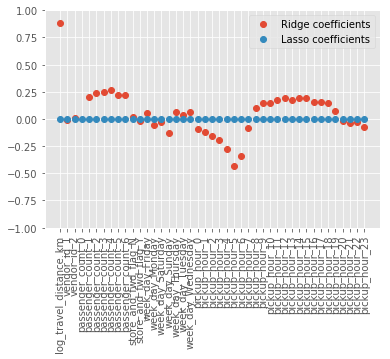

In [73]:
plt.plot(ridge_coef.T, 'o', label="Ridge coefficients")
plt.plot(lasso_coef.T, 'o', label="Lasso coefficients")
plt.xticks(range(len(XX_train.columns)), XX_train.columns.values, rotation=90)
plt.ylim(-1, 1)
plt.legend()
plt.show()

Between `Lasso` and `Ridge`, it is clean we should go on with the later.

### Linear regression with regularization: `ElasticNet`

If we had to chose one kind of regularization, there is no doubt about what penalty should be chosen. Just for pedagogical purposes, we also present the [method](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html) `ElasticNet` which combines L1 and L2 regularizations. An interesting parameter is `l1_ratio` which is a mixing parameter; for `l1_ratio = 0` the penalty is an L2 penalty. For `l1_ratio = 1` it is an L1 penalty and for `0 < l1_ratio < 1`, the penalty is a combination of L1 and L2.

Interestingly, a tiny contribution of an L1 term is enough to a poor generalization.

In [78]:
from sklearn.linear_model import ElasticNet
model = ElasticNet(random_state=0, l1_ratio=0.0000001)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with ElasticNet')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with ElasticNet
0.651556924312904


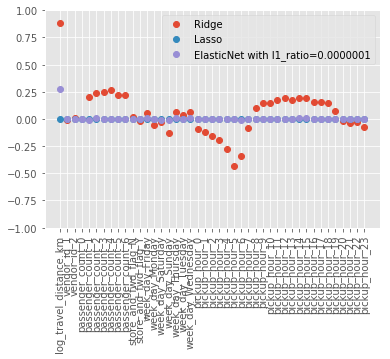

In [80]:
elas_coef = clf.coef_
plt.plot(ridge_coef.T, 'o', label='Ridge')
plt.plot(lasso_coef.T, 'o', label='Lasso')
plt.plot(elas_coef.T, 'o', label='ElasticNet with l1_ratio=0.0000001')
plt.xticks(range(len(XX_train.columns)), XX_train.columns.values, rotation=90)
plt.ylim(-1, 1)
plt.legend()
plt.show()

### Decisions Trees

Essentially, decision trees learn a hierarchy of if-else questions, leading to a decision. In this illustration, taken from the book [Introduction to Machine Learning with Python](http://shop.oreilly.com/product/0636920030515.do) by [Andreas Mueller](http://amueller.io/) and [Sarah Guido](https://twitter.com/sarah_guido) each node in the tree either represents a question or a terminal node (also called a leaf) which contains the answer.

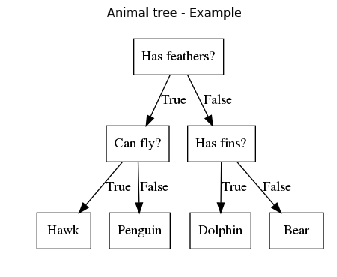

In [3]:
import mglearn
mglearn.plots.plot_animal_tree()
plt.suptitle("Animal tree - Example")
plt.show()

Decision trees may be very intuitive for classification tasks, but one may be wondering how are the questions for continuous data, such as ours. In this they are of the form "is feature $i$ larger than value $a$?". To build a tree, the algorithm searches over all possible questions and find the most informative one about the target variable. The book [Introduction to Machine Learning with Python](http://shop.oreilly.com/product/0636920030515.do) by [Andreas Mueller](http://amueller.io/) and [Sarah Guido](https://twitter.com/sarah_guido) provides a nice visualization of this procedure.

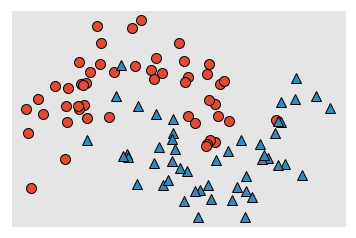

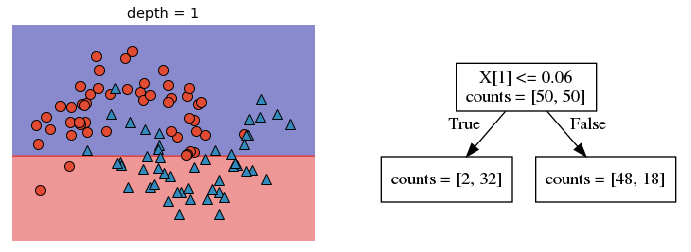

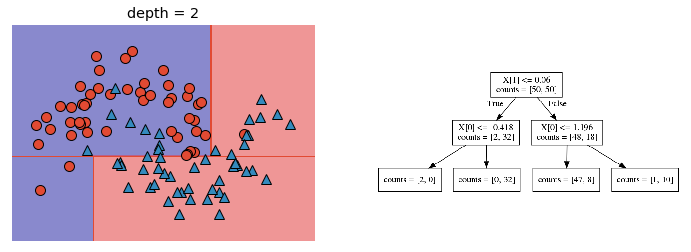

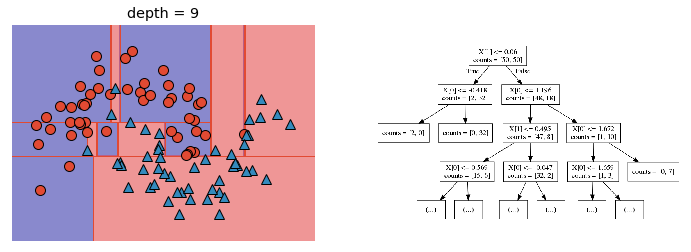

In [4]:
mglearn.plots.plot_tree_progressive()
plt.show()

Typically, building a tree as described and continuing until all leaves are pure leads to very complex models and highly overfit the training data. There are to ways to prevent overfitting:

- Pre-pruning: stop the creation of the tree before it is ended. 
- Post-pruning or pruning: build the tree, but removing or collapsing nodes with little information. 

The scikit-learn library implements only pre-pruning, on which one could limit he maximum depth of the tree by the parameter `max_depth` or even limit the maximum number of leaves with `max_leaf_nodes `. 

As decision trees methods are widely used for classification and even regression tasks, we will give a shot here with `DecisionTreeRegressor` [algorithm](http://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html). There are several important parameters such as `max_depth`, mentioned above


As decision trees methods are widely used for classification and even regression tasks, we will give a shot here with `DecisionTreeRegressor` [algorithm](http://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html). There are several important parameters such as `max_depth` mentioned above and `min_samples_split`, which controls the minimum number of samples required to split an internal node. For now, we will keep all parameters in their [default values](http://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html).

In [92]:
from sklearn.tree import DecisionTreeRegressor
model = DecisionTreeRegressor(random_state= 0,max_depth= None, min_samples_split= 2)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with DecisionTreeRegressor')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with DecisionTreeRegressor
0.661230882441467


We note `Ridge` regression is still better. As $\approx$0.66 is quite far form $\approx$0.49, instead of try to tune the hyperparameters of `DecisionTreeRegressor`, we decide to analyze ensemble methods, which combine multiple models to create more powerful models. 

### Ensembles of Decision Tress

There are some models in this category, but three of them have proven to be effective on a wide range of data set for classification and regression and they use decision trees on the building block: [Random Forests](https://towardsdatascience.com/the-random-forest-algorithm-d457d499ffcd), [Gradient Boosted Decision Trees](https://pt.coursera.org/learn/python-machine-learning/lecture/emwn3/gradient-boosted-decision-trees) and [Extreme Gradient Boosting](http://xgboost.readthedocs.io/en/latest/).

#### Random Forests

Random forests are essentially a collection of decision trees, where each tree is slightly different from the others. The idea: each tree might do a relatively good prediction job, but will likely overfit on part of the data. If many trees are built, all of which working well and overfitting in different ways, the amount of overfitting can be reduced by averaging the results.

The parameter `n_estimator` controls the number of trees in the random forest.

Each tree is built with a [bootstrap](http://stat.rutgers.edu/home/mxie/RCPapers/bootstrap.pdf) sample of the data. A bootstrap sample is constructed by random sampling with replacement of the data points. Then bootstrapping creates a data set as big as the original one, but some data points will be missing from it and some will be repeated. Next, a decision tree is built based on each new data set created by bootstrapping. However,in this context, the decision tree algorithm is slightly modified. Before, it searched for the best test for each node. In this context, it randomly selects in each node a subset of the features and looks for the best possible test involving one of these features. The quantity of selected features is controlled by the `max_features` parameter. This selection is repeated in each node, so each of them make a decision using a different features subset.

Note `max_features` is a critical parameter. If `max_features = n_features` no randomness is injected, while if `max_features = 1` the algorithm has no choice of which feature to test and can only search for thresholds for the randomly selected feature.

Below we aplly `RandomForestRegressor`. For now, we will keep all parameters in their [default values](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html).




In [81]:
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(random_state=0)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with RandomForestRegressor')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with RandomForestRegressor
0.5239454227464584


The result provided by `RandomForestRegressor` with its default hyperparameters is already much better than the one obtained by `DecisionTreeRegressor`. Perhaps we can get smaller score values if we try to tune the random forest parameters using cross-validation.

#### Gradient Boosted Regression Trees 

Gradient boosting models were first proposed in the paper [Greedy Function Approximation: A Gradient Boosting Machine](https://statweb.stanford.edu/~jhf/ftp/trebst.pdf), by [Jerome H. Friedman](https://statweb.stanford.edu/~jhf/). Both Gradient Boosting Regression Trees and XGBoost mentioned in this work are based on this original proposal.

Gradient Boosted Regression Trees (or Gradient Boosted Machines) is another ensemble method combining multiple decision trees to a more powerful model. Despite its name, it can be used for regression and classification.

It works by building trees in a serial manner, where each tree tries to corrected the mistakes of the previous one. There is no randomization. Instead, strong pre-pruning is used. It often uses very shallow trees, of depth one to five, making a faster model with less memory use.

The main idea of gradient boosted: combine many simple models (known as weak learners) like shallow trees. Each tree can provide good predictions only on part of the data, and more and more trees are added to iteratively improve performance.

They are generally a bit more sensitive to parameter settings than random forests, but can provide better accuracy if the parameters are set correctly (pre-pruning, number of trees in the ensemble and learning rate are the model most important features). 

The `learning_rate` parameter controls how strongly each tree tries to correct the mistakes of the previous ones. High `learning_rate` means each tree make strong corrections, allowing for a more complex model. Similarly, adding more trees to the ensemble, `n_estimators` also increases model complexity.

Below we aplly `GradientBoostingRegressor`. For now, we will keep all parameters in their [default values](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingRegressor.html).

In [93]:
from sklearn.ensemble import GradientBoostingRegressor
model = GradientBoostingRegressor(random_state=0)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with GradientBoostingRegressor')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with GradientBoostingRegressor
0.471361235487172


Without changing any of the hyperparameters default values, `GradientBoostingRegressor` achieved the lowest score value so far. Certainly, we will do cross-validation with this algorithm.

#### Extreme Gradient Boosting: XGBoost

[XGBoost](https://arxiv.org/pdf/1603.02754.pdf) is an optimized distributed gradient boosting [library](https://github.com/dmlc/xgboost) designed to be highly efficient, flexible and portable. It implements machine learning algorithms under the [Gradient Boosting framework](http://xgboost.readthedocs.io/en/latest/model.html). [XGBoost](http://xgboost.readthedocs.io/en/latest/) provides a parallel tree boosting (also known as GBDT, GBM) that solve many data science problems in a fast and accurate way. The same code runs on major distributed environment ([Hadoop](https://hadoop.apache.org/), SGE, MPI) and can solve problems beyond billions of examples.

The `xgboost` package is worth looking to apply gradient boosting to a large scale problem, because it is usually faster and sometimes easier to tune than the [scikit-learn](http://scikit-learn.org/) implementation of gradient boosting on many data sets. Below we first apply `XGBRegressor` with its parameters set in their [default values](http://xgboost.readthedocs.io/en/latest/parameter.html).

In [84]:
import xgboost as xgb
model = xgb.XGBRegressor(random_state=0)
clf = model.fit(XX_train, yy_train)
print('Estimating RMSLE on the test set with XGBRegressor')
print(score_kaggle_log( yy_test, clf.predict(XX_test) ) )

Estimating RMSLE on the test set with XGBRegressor
0.47136019069697366


The performance of `XGBRegressor` is almost the same of `GradientBoostingRegressor`, which indicates it is worth tuning the hyperparameters of these two models. Since `Ridge` did not do a bad job either, we will work on tuning its parameters as well.

## Cross-validation and Grid Search

[Cross-validation](https://en.wikipedia.org/wiki/Cross-validation) is a model validation technique for assessing how the results of a statistical analysis will generalize to an independent data set, preventing overfitting. Note that cross-validation does not measure generalization, it just tries to estimate from the training set itself how well the model will generalize.

In cross-validation, the same model is run several times using a fraction of the training set and storing what is left as a validation set, which is used to evaluated the performance of the model. This is procedure is run several times, until all the training data have played the part of a validation set. The cross-validation resulting model is then the average of the ones computed in the loop.

The figure below, taken from this [tutorial](https://www.kaggle.com/dansbecker/cross-validation/code) by [DanB](https://www.kaggle.com/dansbecker) illustrates the procedure for 5 folds.

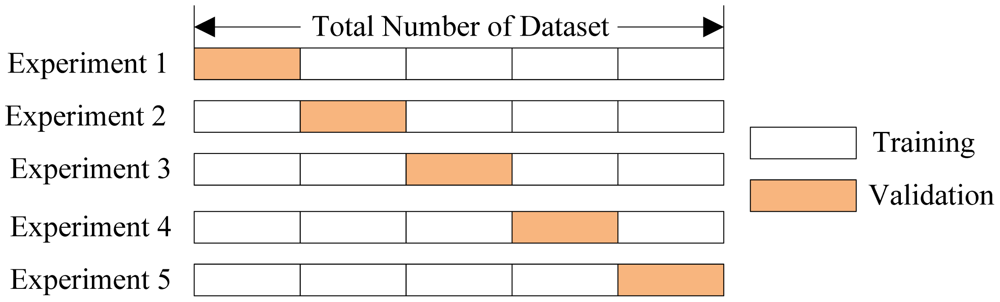

In [36]:
from IPython.display import Image
Image("../../../capstone_project_data/image.png")

Additionally to cross-validation, we use [grid-search](https://en.wikipedia.org/wiki/Hyperparameter_optimization) to estimate the best hyperparameters to generalization. It is simply an exhaustive searching through a manually specified subset of the hyperparameter space of a learning algorithm. A grid search algorithm must be guided by some performance metric, typically measured by cross-validation on the training set or evaluation on a held-out validation set.

For example, let us suppose a machine learning model has at least two hyperparameters that need to be tuned for good performance on unseen data, namely $A$ and $B$. To perform grid search, suppose one selects a finite set of "reasonable" values for each, say $A \in \{ a_1 , a_2 , a_3 \} $ and $ b \in \{ b_1 , b_2 , b_3 \} $. Grid search then trains the model with each pair $(A,B)$ in the Cartesian product of these two sets and evaluates their performance on a held-out validation set (or by internal cross-validation on the training set). Finally,the grid search algorithm outputs the settings that achieved the highest score in the validation procedure.

In [scikit-learn](http://scikit-learn.org/stable/index.html) grid-search and cross-validation are applied [simultaneously](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html) with `GridSearchCV`.



### Cross-validation and Grid-search with Ridge Regression 

First we perform cross-validation with the Ridge Regression by changing the hyperparameter `alpha`, which controls the regularization strength (default=1.0). We also investigate the performance for different choices of `solver`:

- `auto`: chooses the solver automatically based on the type of data.
- `svd`: uses a Singular Value Decomposition of X to compute the Ridge coefficients. 
- `lsqr`: uses the dedicated regularized least-squares routine scipy.sparse.linalg.lsqr. It is the fastest but may not be available in old scipy versions. It also uses an iterative procedure.
- `sag`: uses a Stochastic Average Gradient descent.

In [36]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer

# greater_is_better= False: we want to minimize the root mean square logarithmic error
scorer = make_scorer(score_kaggle_log, greater_is_better= False)

model = Ridge(random_state=0)

parameters = {'alpha': [0.01, 0.1, 1.0, 10.0], 'solver': ['auto', 'lsqr', 'sag', 'svd']}

clf = GridSearchCV(model, param_grid= parameters, scoring= scorer, verbose= 1, n_jobs= -1, cv= 3)

grid_fit = clf.fit(XX_train, yy_train)

print(grid_fit.best_params_)
best_clf = grid_fit.best_estimator_

print(score_kaggle_log( yy_test, best_clf.predict(XX_test) ) )

Fitting 3 folds for each of 16 candidates, totalling 48 fits


[Parallel(n_jobs=-1)]: Done  48 out of  48 | elapsed:  1.7min finished


{'alpha': 0.1, 'solver': 'auto'}
0.492698026491787


The cross-validation procedure suggests we should have set `alpha=0.1` instead of `alpha=1.0` (0.4926978071042146) in order to improve the performance based on the root mean square logarithmic error. The gain is quite small, but in a Kaggle competition could represent several positions on the leaderboard.

### Cross-validation and Grid-search with Random Forest Regression

Now we check the behavior of `RandomForestRegressor` by changing the following hyperparameters:

- `max_depth` : the maximum depth of the tree (default=`None`). If `None`, then nodes are expanded until all leaves are pure or until all leaves contain less than `min_samples_split` samples.
- `n_estimators` : the number of trees in the forest (default=10).
- `min_samples_split`: the minimum number of samples required to split an internal node (default=2)
- `max_features` : the number of features to consider when looking for the best split (default=`auto`). If `auto`, then `max_features=n_features`, if `sqrt`, then `max_features=sqrt(n_features)`.

In [97]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer

# greater_is_better= False: we want to minimize the root mean square logarithmic error
scorer = make_scorer(score_kaggle_log, greater_is_better= False)

model = RandomForestRegressor(random_state=0)

parameters = {'max_depth': [10, 15], 'n_estimators': [20, 30],
              'min_samples_split': [6, 10], 'max_features': ['auto', 'sqrt']}


clf = GridSearchCV(model, param_grid= parameters, scoring= scorer, verbose= 1, cv= 2)

grid_fit = clf.fit(XX_train, yy_train)

print(grid_fit.best_params_)
best_clf = grid_fit.best_estimator_

print(score_kaggle_log( yy_test, best_clf.predict(XX_test) ) )

Fitting 2 folds for each of 16 candidates, totalling 32 fits


[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed: 19.3min finished


{'max_depth': 15, 'max_features': 'auto', 'min_samples_split': 10, 'n_estimators': 30}
0.4724815086016824


Varying three hyperparameters considerably improved the previous score (0.5239454227464584). Although cross-validation has indicated we should keep `max_features = n_features` (no randomness is injected), the other tree hyperparameters should have been changed: the maximum depth of tree increase limited to 15, the minimum number of samples required to split an internal node raised from 2 to 10 (more complexity) and the number of trees in the forest increased from 10 to 20. The RMSLE score for the fictitious test set obtained by the random forest algorithm with these hyperparameters is the best we have obtained so far.

### Cross-validation and Grid-search with Gradient Boosting Regression

Now we check the behavior of `GradientBoostingRegressor` by changing the following hyperparameters:

- `max_depth` : maximum depth of the individual regression estimators (default=3). The maximum depth limits the number of nodes in the tree. The best value depends on the interaction of the input variables.
- `n_estimators` : the number of boosting stages to perform (default=100). Gradient boosting is fairly robust to overfitting so a large number usually results in better performance.
- `min_samples_split`: the minimum number of samples required to split an internal node (default=2)
- `leanirng_rate`: shrinks the contribution of each tree (default0.1). There is a trade-off between `learning_rate` and `n_estimators`.

In [99]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer

# greater_is_better= False: we want to minimize the root mean square logarithmic error
scorer = make_scorer(score_kaggle_log, greater_is_better= False)

model = GradientBoostingRegressor(random_state=0)

parameters = {'max_depth': [3, 5], 'n_estimators': [100, 200],
              'min_samples_split': [2, 6], 'learning_rate': [0.1, 1.0]}

clf = GridSearchCV(model, param_grid= parameters, scoring= scorer, verbose= 1, cv= 2)

grid_fit = clf.fit(XX_train, yy_train)

print(grid_fit.best_params_)
best_clf = grid_fit.best_estimator_

print(score_kaggle_log( yy_test, best_clf.predict(XX_test) ) )

Fitting 2 folds for each of 16 candidates, totalling 32 fits


[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed: 86.5min finished


{'learning_rate': 0.1, 'max_depth': 5, 'min_samples_split': 2, 'n_estimators': 200}
0.46219359665138765


Varying two hyperparameters slightly improved ($\approx$1.95%) the previous score (0.471361235487172). As mentioned before, such a gain could not appear to be worthwhile, especially if we compare the training times so far (note `GradientBoostingRegressor` took much more time to train). Yet 2% in a competition could represent several positions in the leaderboard. 

Although cross-validation has indicated we should keep `learning_rate=0.1` and `min_samples_split=2`, the other two hyperparameters should have been changed: the maximum depth of the individual regression estimators (limits the number of nodes in the tree) increased from 3 to 5 and the number of boosting stages to perform from 100 to 200. The RMSLE score for the fictitious test set obtained by the gradient boosting algorithm with these hyperparameters is the best we have obtained so far.

### Cross-validation and Grid-search with XGBoost Regression

Now we check the behavior of `XGBRegressor` by changing the following [hyperparameters](http://xgboost.readthedocs.io/en/latest/python/python_api.html):

- `max_depth` : maximum depth of a tree (default=3), increase this value will make the model more complex/likely to be overfitting.
- `n_estimators` : number of boosted trees to fit (default=100).
- `leanirng_rate`: shrinks the contribution of each tree (default=0.1). 
- `min_samples_split`: the minimum number of samples required to split an internal node (default=2)
- `reg_lambda`: L2 regularization term on weights (default=1.0). 

In [273]:
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer

# greater_is_better= False: we want to minimize the root mean square logarithmic error
scorer = make_scorer(score_kaggle_log, greater_is_better=False)

model = xgb.XGBRegressor(random_state=0)

parameters = {'max_depth': [5, 10, 20], 'n_estimators': [100, 200],
              'learning_rate': [0.1, 1.0], 'reg_lambda': [0.1, 1.0] }

clf = GridSearchCV(model, param_grid= parameters, scoring= scorer, verbose= 1, n_jobs= -1, cv=2)

grid_fit = clf.fit(XX_train, yy_train)

print(grid_fit.best_params_)
best_clf = grid_fit.best_estimator_

print(score_kaggle_log( yy_test, best_clf.predict(XX_test) ) )

Fitting 2 folds for each of 24 candidates, totalling 48 fits


[Parallel(n_jobs=-1)]: Done  48 out of  48 | elapsed: 112.6min finished


{'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200, 'reg_lambda': 1.0}
0.46214027536016206


Juke like `GradientBoostingRegression`, the variation is suggested only on maximum depth (from 3 to 5) and number of estimators (from 100 to 200). The performance is also very similar ($\approx$0.01% in favor of `XGBRegressor`). The major advantage in favor to extreme boosting in this case is the training time. While each fit using the usual gradient boosting took, on average, 2.7 minutes, extreme boosting took 2.35 minutes (on average) to complete each fit. This would represent more than an hour if we had more than 170 fits.

## Training with full training data using the cross-validation hyperparameters and submitting to Kaggle

Although up to now boosting methods have led to better results, we still have not trained any algorithm with full training data in order to make predictions on the real test set. Since ridge regression and random forests are quite fast to train and did not lead to terrible estimators, we are still using them in this final section.

As mentioned before, performance of predictions on the real test set cannot be evaluated here. The final score is achieved only when a submission to Kaggle is made.

The winner team, composed by [Francesco Palma](https://www.kaggle.com/lapalma), [Aldo Podestá](https://www.kaggle.com/aldopod), [TomBoy](https://www.kaggle.com/tomboys) and [W.R. Lemes de Oliveira](https://www.kaggle.com/wallyoliveira) obtained the score 0.28976 on the private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard), which is calculated with approximately 70% of the test data. Naturally, their solution is the benchmark model. However, it seems clear to us that, to begin with, much more sophisticated data preprocessing and future extraction, perhaps using clusters and principal component analysis, should be carried on in order to achieve some score close to theirs. Since our purpose is learning, not competing, we define our goal as reaching a score less than 0.5 on the private learderboard.

### Benchmark

The winner team, composed by [Francesco Palma](https://www.kaggle.com/lapalma), [Aldo Podestá](https://www.kaggle.com/aldopod), [TomBoy](https://www.kaggle.com/tomboys) and [W.R. Lemes de Oliveira](https://www.kaggle.com/wallyoliveira) obtained the score 0.28976 on the private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard), which is calculated with approximately 70% of the test data. Naturally, their solution is the benchmark model. However, it seems clear to us that, to begin with, much more sophisticated data preprocessing and future extraction, perhaps using clusters and principal component analysis, should be carried on in order to achieve some score close to theirs. 

Since our purpose is learning, not competing, we define our benchmark as the score obtained on the private learderboard with the most naive and straightforward estimation we could make: the mean value on the training set.

In [35]:
mean_naive_trip_duration = np.exp(np.mean(y_train)) - 1
mean_naive_trip_duration

645.8218576931354

In [46]:
test_data_pred = np.empty([625134,])
test_data_pred.fill(mean_naive_trip_duration)

In [47]:
test_data_pred

array([645.82185769, 645.82185769, 645.82185769, ..., 645.82185769,
       645.82185769, 645.82185769])

In [49]:
subm = np.column_stack((np.asarray(test_data.index.values), np.asarray(test_data_pred, dtype=np.float32)))

np.savetxt('kaggle_submissions/mean_naive.csv',subm, delimiter=',', comments='',  newline='\n', fmt='%s', 
           header = 'id,trip_duration')

submission = pd.read_csv('kaggle_submissions/mean_naive.csv', index_col= 'id')

print(submission.shape)
submission.head()

(625134, 1)


,trip_duration
id,
id3004672,645.821838
id3505355,645.821838
id1217141,645.821838
id2150126,645.821838
id1598245,645.821838


The submission file above, constructed with the most naive estimation we could make, the mean value of `trip_duration` in the training set, achieved the benchmark score 0.79807 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard).

### Ridge Regression

We start by training a Ridge regressor with regularization strength `alpha` equals to 0.1, following the cross-validation analysis.

In [37]:
from sklearn.linear_model import Ridge

model = Ridge(random_state= 0, alpha= 0.1) 

clf = model.fit(X_train, y_train)
test_data_pred =  np.exp( clf.predict(test_data)) - 1 

In [39]:
test_data_pred.shape

(625134,)

Now we create the submission file.

In [31]:
subm = np.column_stack((np.asarray(test_data.index.values), np.asarray(test_data_pred, dtype=np.float32)))

np.savetxt('kaggle_submissions/sub_ridge_01.csv',subm, delimiter=',', comments='',  newline='\n', fmt='%s', 
           header = 'id,trip_duration')

submission = pd.read_csv('kaggle_submissions/sub_ridge_01.csv', index_col= 'id')

print(submission.shape)
submission.head()

(625134, 1)


,trip_duration
id,
id3004672,527.985168
id3505355,557.777771
id1217141,431.186310
id2150126,1094.977539
id1598245,362.712311


The submission file above, constructed with Ridge regression achieved the score 0.51054 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard), which is already much better than the benchmark.

### Random Forest Regression

We now train using random forest regression with `max_depth=15`, `min_samples_split= 10` and `n_estimators=30`, following the cross-validation analysis.

In [32]:
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(random_state=0, max_depth=15, min_samples_split= 10, n_estimators=30) 

clf = model.fit(X_train, y_train)
test_data_pred =  np.exp( clf.predict(test_data)) - 1 

Now we create the submission file.

In [33]:
subm = np.column_stack((np.asarray(test_data.index.values), np.asarray(test_data_pred, dtype=np.float32)))

np.savetxt('kaggle_submissions/sub_rfr.csv',subm, delimiter=',', comments='',  newline='\n', fmt='%s', 
           header = 'id,trip_duration')

submission = pd.read_csv('kaggle_submissions/sub_rfr.csv', index_col= 'id')

print(submission.shape)
submission.head()

(625134, 1)


,trip_duration
id,
id3004672,525.145935
id3505355,575.431580
id1217141,424.096619
id2150126,1167.800293
id1598245,320.820068


The submission file above, constructed with Random Forest regression achieved the score 0.51063 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard). Ridge regression, though its simplicity, is still better.

### Extreme Gradient Boosting 

We now train using extreme gradient boosting with `learning_rate=0.1`, `max_depth=5`, `n_estimators=200` following the cross-validation analysis.

In [274]:
import xgboost as xgb

model = xgb.XGBRegressor(random_state= 0, learning_rate= 0.1, max_depth= 5,
                         n_estimators= 200, reg_lambda= 1.0) 

clf = model.fit(X_train, y_train)
test_data_pred =  np.exp( clf.predict(test_data)) - 1 

Now we create the submission file.

In [275]:
subm = np.column_stack((np.asarray(test_data.index.values), np.asarray(test_data_pred, dtype=np.float32)))

np.savetxt('kaggle_submissions/submission_xgb_new2.csv',subm, delimiter=',', comments='',  newline='\n', fmt='%s', 
           header = 'id,trip_duration')

submission = pd.read_csv('kaggle_submissions/submission_xgb_new2.csv', index_col= 'id')

print(submission.shape)
submission.head()

(625134, 1)


,trip_duration
id,
id3004672,545.886963
id3505355,575.420105
id1217141,415.583862
id2150126,1159.463501
id1598245,328.970612


The submission file above, constructed with Extreme Gradient Boosting achieved the score 0.49961 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard) and this result fulfills our needs for now, since we have defined our goal as a score less than 0.5.

### Gradient Boosting 

Finishing, we now train using gradient boosting with `learning_rate=0.1`, `max_depth=5`, `min_samples_split=2`, `n_estimators=200` following the cross-validation analysis.

In [122]:
from sklearn.ensemble import GradientBoostingRegressor

model = GradientBoostingRegressor(random_state=0, max_depth=5,min_samples_split=2 , 
                                  n_estimators=200, learning_rate=0.1) 

clf = model.fit(X_train, y_train)
test_data_pred =  np.exp( clf.predict(test_data)) - 1 


clf_final = clf

Creating the submission file.

In [101]:
subm = np.column_stack((np.asarray(test_data.index.values), np.asarray(test_data_pred, dtype=np.float32)))

np.savetxt('kaggle_submissions/submission_grad_boost.csv',subm, delimiter=',', comments='',  newline='\n', fmt='%s', 
           header = 'id,trip_duration')

submission = pd.read_csv('kaggle_submissions/submission_grad_boost.csv', index_col= 'id')

print(submission.shape)
submission.head()

(625134, 1)


,trip_duration
id,
id3004672,544.893555
id3505355,586.763123
id1217141,419.947845
id2150126,1158.659790
id1598245,327.150146


The submission file above, constructed with the usual Gradient Boosting regression achieved the score 0.49960 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard). Similarly to our estimation analysis, it is almost the same result as the one obtained using extreme boosting.

## Model Evaluation and Validation of the Final Model

Since the best score was achieved by `GradientBoostingRegressor`, this will be taken as our final model. In order to validate the robustness of the model’s solution we run the model with multiple different random states and analyze the mean and the standard deviation of the predicted values for `test_duration`.

In [90]:
from sklearn.ensemble import GradientBoostingRegressor

mean_list = []
std_list = []
random_list = []

for i in range(10):
    random_state = np.random.randint(low=0, high=100000)
   
    model = GradientBoostingRegressor(random_state=random_state, max_depth=5,
                                      min_samples_split=2, n_estimators=200, 
                                      learning_rate=0.1) 
    clf = model.fit(X_train, y_train)
    test_data_pred =  np.exp( clf.predict(test_data)) - 1
    
    mean_list.append(np.mean(test_data_pred))
    std_list.append(np.std(test_data_pred))
    random_list.append(random_state) 

We can check below that the model's dependence with the random number generator seed is negligible, which indicates a reasonable degree of robustness.

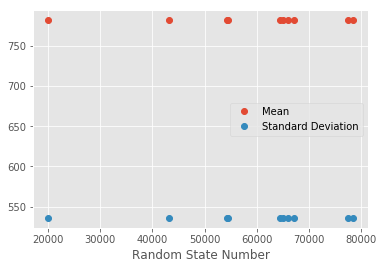

In [105]:
plt.plot(random_list, mean_list, 'o', label= 'Mean')
plt.plot(random_list, std_list, 'o', label= 'Standard Deviation')
plt.xlabel('Random State Number')
plt.legend()
plt.show()

In [113]:
print(np.min(mean_list))
print(np.max(mean_list))

np.min(mean_list) / np.max(mean_list)

781.7650576403955
781.7768907607054


0.9999848638141524

In [111]:
print(np.min(std_list))
print(np.max(std_list))

np.min(std_list) / np.max(std_list)

535.9442982005273
535.9871388111197


0.9999200715698376

### Justification

Besides being robust, the performance of the model constructed with `GradientBoostingRegressor` was considerable better (0.49960 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard)) than our naive benchmark (0.79807 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard)).

## Conclusions

### Free-Form Visualization

It is interesting to visualize the attribute `feature_importances_` from [`GradientBoostingRegressor`](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingRegressor.html). The higher the feature importance value, the more important the feature.


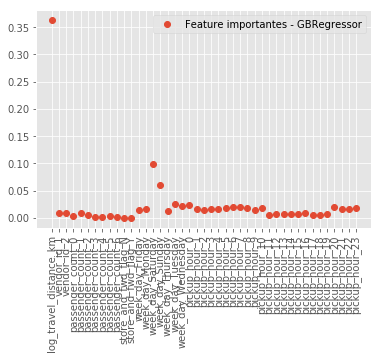

In [124]:
plt.plot(clf_final.feature_importances_.T, 'o', label='Feature importantes - GBRegressor')
plt.xticks(range(len(XX_train.columns)), XX_train.columns.values, rotation=90)
plt.legend()
plt.show()

Clearly, as it should be reasonable to guess, the most important feature is travel distance. Weekends (take a look at `week_day_Saturday` and `week_day_Sunday`), as we have discussed before, also play an important role, just like some values of pickup hour.

### Reflection

In the first steps of the project, as in almost all machine leaning applications, we have conducted data visualization and data preprocessing. Numerical skewed data was log-transformed and some meaningless examples, based on an defined distance, were carefully neglected. After that, a visual investigation was carried to extract at least new insights about the remaining features.

In the training part, after running simple linear models, we chose to investigate in detail the application of ensemble methods, namely: random forest and gradient boosting. Since we did not have directly access to the train targets, we have constructed a fictitious test set with test targets using part of the training data. Then, by making use of the conclusion obtained with grid-search and cross-validation we have found `GradientBoostingRegressor` as the best algorithm choice to be applied to all training data. It achieved score 0.49960 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard)), which represented an considerable improvement to our naive benchmark (0.79807 on private [leaderboard](https://www.kaggle.com/c/nyc-taxi-trip-duration/leaderboard)).  

To finish, the model was validated by the analysis of mean and standard deviation of multiple models run with different random generator seed. Also, visualization of feature importance has showed that travel distance is the most relevant feature in the dataset. Perhaps this indicates we have spent too much time dealing with features other than latitude and longitude, when in fact these are the ones we should had taken a more careful look.

### Improvement

Since we have built multiple models, a possible improvement would be to 'ensemble' all of them. Typically, it is possible to 'squeeze out' a few more percentage points by doing so. This could be done with [`scipy.optimize.minimize`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.minimize.html).

Another possible improvement was already mentioned before: map visualization and improved analysis could be carried on with latitude and longitude coordinates, as done in many Kaggle [kernels](https://www.kaggle.com/c/nyc-taxi-trip-duration/kernels) related with this competition. As we have chosen to merge the four coordinates columns in a simple way to just one new feature, some relevant information could be lost. The feature importance plot above has showed us that the most relevant information comes from these features.